In [ ]:
# DSP AUDIO EDIT (V 1.0)

# Changelog:
#   Edit Audio With Learning
#   Increase or Decrease Complete Volume -- helps to set better background muscic
#   Change the pitch to any that you want
#   Minimize the noise in your sound
#   Link/ Upload the sound file

In [1]:
!pip install librosa        # Audio Data Library
!pip install ipython        # Interactive widgets to load/play files
!pip install matplotlib     # Plotting graphs
!pip install numpy          # Numerical Based Calculations
!pip install scipy          # Scientific pi
!pip install requests       # For Downloading Resources

In [2]:
# Now we are downloading a "MUSIC"/"Any audio file"/"Uploading your own file"
# Link example:  https://drive.google.com/u/3/uc?id=1VDQQjFbI2Fg1iOflfizeRgkeSOKa5kbd&export=download

# Upload the file or Provide the link of File
print("1. Upload File\n2. Provide Download Link")
selection = int(input())
if selection == 1:
  from google.colab import files
  uploaded = files.upload()
else: 
  print("Enter the URL: ")
  urlIn = input()
  import urllib.request  
  urllib.request.urlretrieve(urlIn, "input.wav")

1. Upload File
2. Provide Download Link
2
Enter the URL: 
https://drive.google.com/u/3/uc?id=1VDQQjFbI2Fg1iOflfizeRgkeSOKa5kbd&export=download


In [3]:
# Sampling rate or sampling frequency defines the number of samples 
#   per second (or per other unit) taken from a continuous signal 
#   to make a discrete or digital signal.

#   https://dvrblacktech.000webhostapp.com/scilab_course_4.htm


# Getting the amplitudes and the sampling rate
import librosa
audio_path = "input.wav"
if selection==1:
  audio_path = next(iter(uploaded))
samples, samplingRate = librosa.load(audio_path, sr = None, 
                                     mono = True, offset = 0.0,
                                     duration = None)

In [4]:
# Displaying    Sampling rate
#               Total Amplitudes
print(len(samples), samplingRate)

3245714 48000


In [5]:
print("\n For every second of a muscic, ", samplingRate," samples of amplitudes are taken")
print("\n Totally we have ",len(samples), "amplitude samples.") 
print("\n So total Duration : totalSamples/SamplingRate = \n\t\t\t",len(samples)/samplingRate," Seconds. i.e :", end=" ")
print((len(samples)/samplingRate)/60," Minutes.")


 For every second of a muscic,  48000  samples of amplitudes are taken

 Totally we have  3245714 amplitude samples.

 So total Duration : totalSamples/SamplingRate = 
			 67.61904166666666  Seconds. i.e : 1.1269840277777776  Minutes.


In [6]:
print("Verify the audio length from here\n")
from IPython.display import Audio
Audio(audio_path,autoplay=True)

Verify the audio length from here



Lets See the waveforms of this Audio

This is in TIME DOMAIN



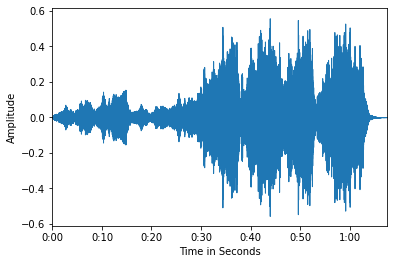

Samples in Time Domain:
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ... -1.5258789e-05
 -1.5258789e-05 -1.5258789e-05]


In [7]:
print("Lets See the waveforms of this Audio\n")
print("This is in TIME DOMAIN\n")

from librosa import display
import matplotlib.pyplot as plt
plt.figure()
librosa.display.waveplot(y = samples, sr = samplingRate)
plt.xlabel("Time in Seconds")
plt.ylabel("Amplitude")
plt.show()

print("Samples in Time Domain:\n", samples)

In [8]:
print("From the above representation, We can tell that,\n\n")
print("1] For some part, amplitude is HIGH and for some LOW or zero")
print("   So we can understand how scilent or loud is the audio\n")

From the above representation, We can tell that,


1] For some part, amplitude is HIGH and for some LOW or zero
   So we can understand how scilent or loud is the audio



Let's apply FAST FOURIER TRANSFORM(FFT) on these audio signals
We know that our muscic's sample rate is:  48000
And WKT, a signal can be exactly reproduced if it is sampled at the
rate fs which is greater than twice the maximum frequency of inputs
So, the maximum frequency is : samplingRate/2 =  24000.0 Hz

Audible Frequency Range: 20Hz to 20,000Hz
Frequency other that this range can be treated as noise



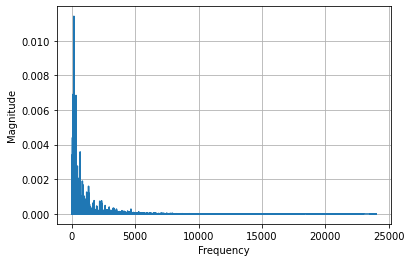

In [9]:

# https://dvrblacktech.000webhostapp.com/scilab_course_5.htm
print("Let's apply FAST FOURIER TRANSFORM(FFT) on these audio signals")
print("We know that our muscic's sample rate is: ",samplingRate)
print('''And WKT, a signal can be exactly reproduced if it is sampled at the
rate fs which is greater than twice the maximum frequency of inputs''')
print("So, the maximum frequency is : samplingRate/2 = ",samplingRate/2, "Hz\n")

print("Audible Frequency Range: 20Hz to 20,000Hz")
print("Frequency other that this range can be treated as noise\n")

import scipy.fft
import numpy as np

T = 1/samplingRate
n = len(samples)
F_y = scipy.fft.fft(samples)
F_x = np.linspace(0.0, 1.0/(2.0*T), n//2)
fig, ax = plt.subplots()
ax.plot(F_x,2.0/n *np.abs(F_y[:n//2]))
plt.grid()
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.show()

In [10]:
print("Let's see our audio in FREQUENCY DOMAIN\n")
print(F_y)

print('''\n, Here we can even observe the SYMMETRICAL property of DFT\n
          0,1,2,3,4...........n Values\n
          Real part of X(K) is even and  Imaginary part of X(K) is odd\n 
          ''')

Let's see our audio in FREQUENCY DOMAIN

[-13.896772  -0.j         -11.637001 +15.910206j
   8.365205  +0.21565346j ...  -7.6980786 -4.5375648j
   8.365205  -0.21565346j -11.637001 -15.910206j  ]

, Here we can even observe the SYMMETRICAL property of DFT

          0,1,2,3,4...........n Values

          Real part of X(K) is even and  Imaginary part of X(K) is odd
 
          


In [11]:
print('''\t High Sampling Rate --> High Pitch Sound\n
         Low  Sampling Rate --> Low  Pitch Sound\n
         0    Sampling Rate --> Scilence\n\n


         Increased Frequency  in DFT --> High Volume 
         Reduced   Frequency  in DFT --> Low Volume

         Now, let's alter the frequency and sampling rate to change
         our muscic/voice\n
         
         Choose whether to \n
          1] Increase the Volume (zero included here)\n
          2] Decrease the Volume (don't give zero)\n\n
          
          3] Increase/Decrease the Pitch \n\n
         ''')
select = int(input())

if select==1:
  print("Normal 1\nIncreasing Volume times (any float/int value): Ex: 1.5, 2, 2.5........5 ,6 ,7 ,8 ...10,12....")
  freqCom = float(input())
  F_y_altered = (F_y*freqCom)
  pitch = 1
elif select==2: 
  print("Normal 2\nDecreasing Volume times (any float/int value): Ex: 1.5, 2, 2.5........5 ,6 ,7 ,8 ...10,12....")
  freqCom = float(input())
  F_y_altered = (F_y/freqCom)
  pitch = 1
else:
  print(" Normal Pitch = 1\n Increaseing Pitch = 1.1, 1.2, 1.3, 1.4..., 2, 2.1.....\n Decreasing Pitch = 0.9, 0.8, 0.7, 0.6.......0.09 ,0.08 .....")
  pitch = float(input())
  F_y_altered = F_y

if select==1 or select ==2:
  print("\nAltered Frequency values:")
  print(F_y_altered);

else:
  print('''Changing the Pitch alter the sample rate\n
  So, Sample rate = ''',int(samplingRate*pitch))

	 High Sampling Rate --> High Pitch Sound

         Low  Sampling Rate --> Low  Pitch Sound

         0    Sampling Rate --> Scilence




         Increased Frequency  in DFT --> High Volume 
         Reduced   Frequency  in DFT --> Low Volume

         Now, let's alter the frequency and sampling rate to change
         our muscic/voice

         
         Choose whether to 

          1] Increase the Volume (zero included here)

          2] Decrease the Volume (don't give zero)


          
          3] Increase/Decrease the Pitch 


         
2

Enter the pitch numer

5

Altered Frequency values:
[-2.7793546+0.j         -2.3274002+3.1820412j   1.673041 +0.04313069j ...
 -1.5396158-0.90751296j  1.673041 -0.04313069j -2.3274002-3.1820412j ]


In [12]:
print(""" Lets take the IDFT on our altered Signal\n
So we get back to time Domain from frequency domain""")
samples_altered = np.real_if_close(np.fft.ifft(F_y_altered))

print("This is the altered samples in time Domain\n")
print(samples_altered)


#buffer error  https://github.com/librosa/librosa/issues/915
samples_altered = np.ascontiguousarray(samples_altered)

 Lets take the IDFT on our altered Signal

So we get back to time Domain from frequency domain
This is the altered samples in time Domain

[-6.40832657e-09  7.53010760e-09  7.65083847e-09 ... -3.05086282e-06
 -3.03944650e-06 -3.04509703e-06]


Let's ploat again the graph in Time Domain

Now we have amplitude and the time


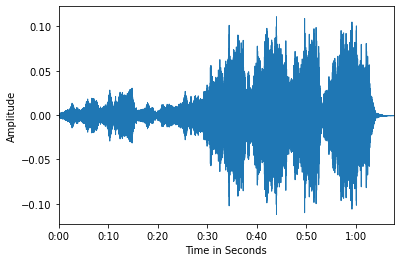

In [13]:
print('''Let's ploat again the graph in Time Domain\n
Now we have amplitude and the time''')

plt.figure()
librosa.display.waveplot(y = samples_altered, sr = int(samplingRate*pitch))
plt.xlabel("Time in Seconds")
plt.ylabel("Amplitude")
plt.show()

In [14]:
#Requires VLC media player to open this file
#File in saved in the same directory with name "output.wav"
librosa.output.write_wav('output.wav', samples_altered, int(samplingRate*pitch))

In [15]:
print("THANK YOU  <>  DVRBLACKTECH")

THANK YOU  <>  DVRBLACKTECH
